In [207]:
import os
import re
def DIR2lasti(DIR,pattern='seed(\d+)_size600'):
    dlst = os.listdir(DIR)
    dlst = ''.join(dlst)
    it = re.findall(pattern,dlst)
    lasti = max(map(int,it))
    return lasti
DIR = 'data_rand/'

import numpy as np
fs = [x for x in os.listdir(DIR,) if x.startswith('seed')]
idx = re.findall('seed(\d+)_',''.join(fs))
# fs = sorted
fs = np.take(fs,np.argsort(np.array(idx,int)))
out = sum((np.load(os.path.join(DIR,f)).tolist()  for f in fs),[])
print len(fs)
print fs[:10]


289
['seed0_size40.npy' 'seed1_size40.npy' 'seed2_size40.npy'
 'seed3_size40.npy' 'seed4_size40.npy' 'seed5_size40.npy'
 'seed6_size40.npy' 'seed7_size40.npy' 'seed8_size40.npy'
 'seed9_size40.npy']


In [102]:
%%time
# %matplotlib notebook
from pymisca.util import *
from pymisca.vis_util import *
import IPython.display as ipd

import KBs
import random
import workers
reload(workers)

tst_dct = KBs.tst_dct
try:
    tst_out = np.load('%s/reference.npy'%DIR,).tolist()
except:
    tst_out = mp_map(workers.worker0325,tst_dct,n_cpu=6)
    np.save('%s/reference.npy'%DIR,tst_out)
print 'finished'

finished
CPU times: user 0 ns, sys: 0 ns, total: 0 ns
Wall time: 787 µs


In [74]:
lst = []
oit = list(range(0,60*24))
for seed in oit:
    bsize= 40
    worker = workers.worker0325
    kb = KBs.kb_2dntca()
    it = kb.bulk_rstr(seed=seed,bsize=bsize)
    lst += it
out_dct = lst

In [44]:
np.repeat(range(len(df)),NP).size
np.shape(tst_out)

(32, 4, 5)

In [47]:
?np.reshape

In [208]:
%matplotlib notebook
import pandas as pd
df0 = pd.DataFrame()
def tidy(tst_out,color='red'):
    _,NCOL,NP=np.shape(tst_out)
    # plt.figure(figsize=(8,7))
    # dt  = map(lambda x:x.get('data').get('med'),tst_out)
    df = pd.DataFrame(
        np.reshape(
            np.moveaxis(tst_out,1,2),
            (-1,NCOL))
    )

    df['color']=color
    df['idx']=np.repeat(range(len(df)//NP),NP)
    return df
# df0 = df
df0 = pd.DataFrame()
df = tidy(tst_out,'red')
# df = df.loc[(df['idx']>30),:]
df0 =  df0.append(df)
print df.head()

df = tidy(out,'blue')
df = df.loc[(df['idx']>8000),:]
df0 = df0.append(df)

df0 = df0.loc[(df0[1]<0.8)|(df0[1]>0),:]
df0 = df0.loc[(df0[1]<0.7)|(df0[2]>100),:]
df0 = df0.loc[(df0[1]>0.15)|(df0[2]>60),:] ###bot left
df0 = df0.loc[(df0[0]<=0.001),:]
# df0 = df0.loc[(df0[3]>0.40),:]
print len(df0)



        0         1          2         3 color  idx
0  0.1000  0.802922   0.356674  0.110257   red    0
1  0.0100  0.597655  17.637930  0.215136   red    0
2  0.0010  0.315607  59.316446  0.458104   red    0
3  0.0001  0.181261  80.812069  0.586445   red    0
4  0.0000  0.303133  55.209619  0.480425   red    0
410


<IPython.core.display.Javascript object>


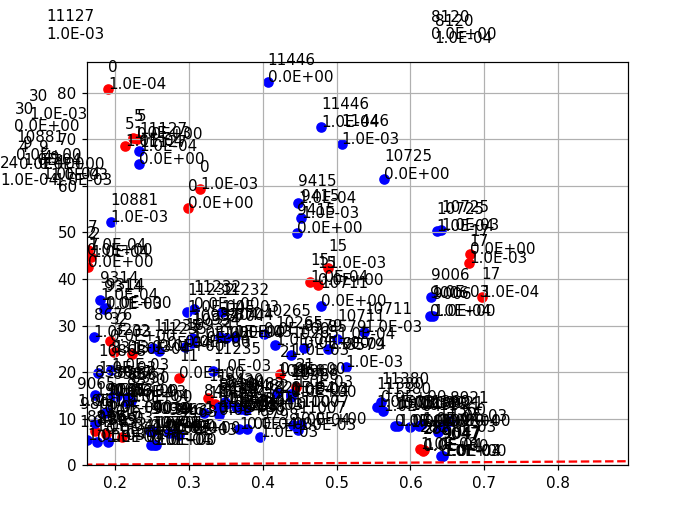

In [209]:
def plotter(df):
    cmap = plt.get_cmap()
    pdata = df.iloc[:,[0,1,2,4,5]].as_matrix()
    # plt.scatter(*pdata,color='red')
    for p,x,y,c,i in pdata:
        x = x+(np.random.random()-0.5)/50.
        y = y+(np.random.random()-0.5)/50.
        plt.scatter(x,y,color=c)
        plt.text(x,y,'%s\n%.1E'%(i,p) )
    plt.plot([0,1],[0,1],'--',color='red')
    plt.xlim(0,1)
    plt.ylim(0,250)
    plt.grid()

plotter(df0)
plt.show()

,0,1,2,3,color,idx
55637,0.0010,0.097855,91.580387,0.871662,blue,11127
55638,0.0001,0.227102,67.471024,0.748170,blue,11127
55639,0.0000,0.225960,64.679942,0.754119,blue,11127


11127
http://newflaw.com/view.php?rule_alias=b1ce03aciknqry2acek5aeijky4jknz6ais1e03ciy2ain5ajkny4cejknz6ckn


<IPython.core.display.Javascript object>


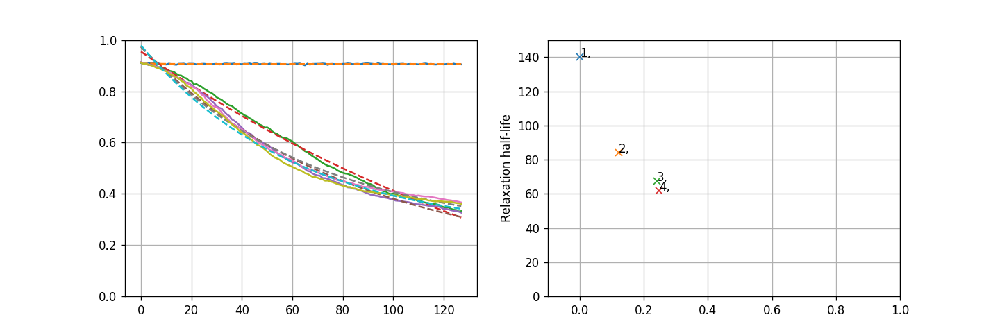

2.072526E-06 [0.90629894 3.48952212 0.00617618]
2.036871E-04 [ -0.40208728 195.84241598   1.35694904]
3.543878E-04 [ 0.12167299 84.05812871  0.85150415]
3.255359E-04 [ 0.24108989 67.28752521  0.73379681]
3.858988E-04 [ 0.24746677 61.91420616  0.73116173]


In [239]:
# KBs.guess(sysX=o)
# i = 3073
# i = 2085
# i = 3206
# i = 1892
# i = 3896
# i = 505
# i = 5935
# i = 8450
# i = 9415
# i = 10725
i = 9572
i = 10438
i = 8809
i = 11232
i = 9314
i = 8704
i = 10934
i = 11235
i = 10482
i = 9798
i = 10968
i = 11360
i = 9047
i = 11380
i = 11446
i = 11127
# i = 11007
# i = 5322
# i = 6274

ipd.display(ipd.HTML(df0[df0['idx']==i].to_html()))

print i
env = KBs.guess(dct=out_dct[i])
KBs.lview(env)
o = worker0325(dct=out_dct[i],as_raw=1)
plotter3(o)

In [186]:
i = 3
env = KBs.guess(dct=tst_dct[i])
KBs.lview(env)

http://newflaw.com/view.php?rule_alias=b1e03aeiknry2ceikn5acq4aejqrtwz7c6aekns1ce03aij2cei5ijkny4ajt6ik8


'http://newflaw.com/view.php?rule_alias=b1e03aeiknry2ceikn5acq4aejqrtwz7c6aekns1ce03aij2cei5ijkny4ajt6ik8'

<IPython.core.display.Javascript object>


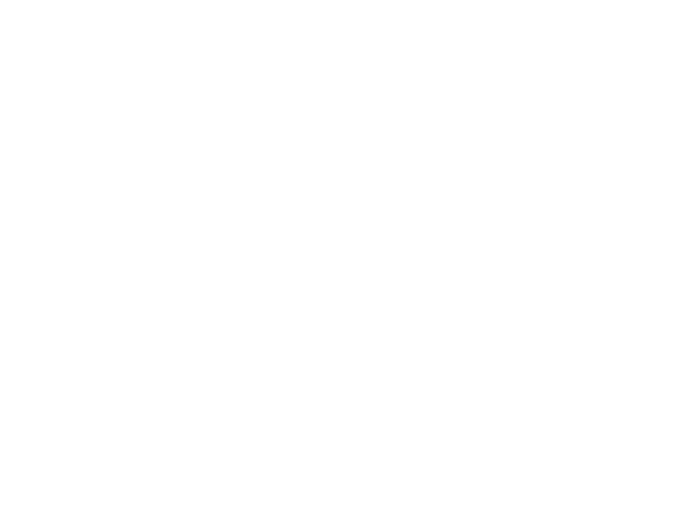

In [175]:
reload(KBs)
import KBs
from KBs import *
env = guess(dct=out_dct[6410])
adv = mix_adv(fill_ber,env.adv,1E-2)
env.change_size((10,512,128**2))
hist = sample(env,adv=adv)
anim = animate(hist[:,4]);
plt.close()
ipd.display(anim)

In [193]:
ipd.display(anim)

<IPython.core.display.Javascript object>


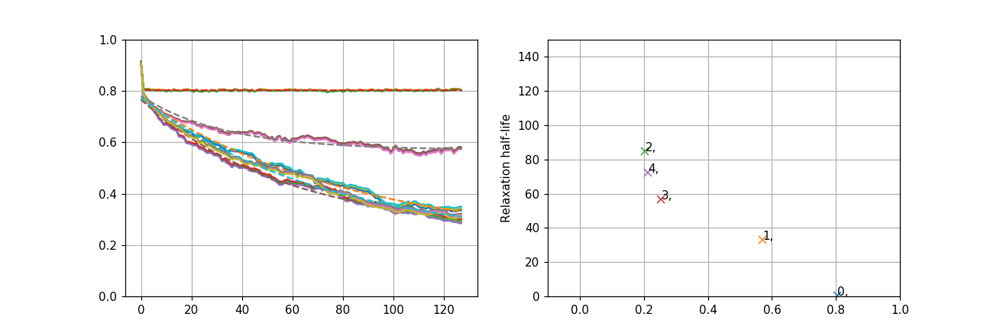

5.950900E-06 [0.80312748 0.34530308 0.10645273]
2.911991E-04 [ 0.57006584 32.96643339  0.21074699]
3.019209E-04 [ 0.20394486 84.91611321  0.56370409]
3.099232E-04 [ 0.25393919 56.91246036  0.51289611]
2.937950E-04 [ 0.2128519  72.48272508  0.56047018]


In [171]:
o = worker0325(dct=tst_dct[0],as_raw=1)
plotter3(o)

<IPython.core.display.Javascript object>


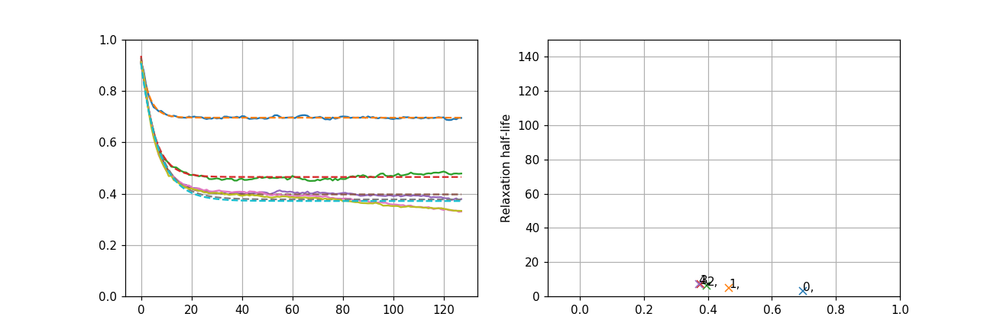

1.741160E-05 [0.69614222 3.32575084 0.22599411]
8.994975E-05 [0.46503438 5.07581875 0.47211905]
5.896063E-05 [0.39719182 6.2340679  0.53279451]
4.783715E-04 [0.37759498 7.22581014 0.53116622]
3.554802E-04 [0.37141772 7.09872055 0.53762127]


In [229]:
o = worker0325(dct=out_dct[9798],as_raw=1)
plotter3(o)

<IPython.core.display.Javascript object>


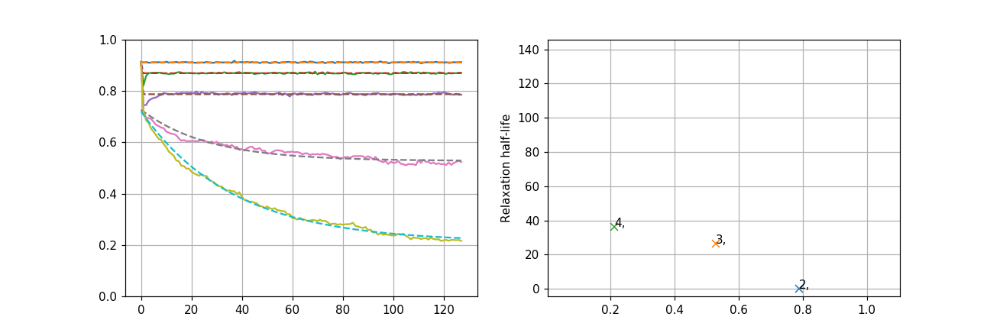

2.357439E-06 [0.91172046 0.03502202 0.0026167 ]
2.249070E-05 [8.69453010e-01 3.69454620e-04 4.04590997e-02]
5.054890E-05 [0.78768308 0.04253931 0.12485354]
4.157466E-04 [ 0.52763021 26.49412478  0.19977204]
4.120005E-04 [ 0.21123222 36.4548599   0.50948646]


In [183]:
o = worker0325(dct=tst_dct[32],ps=10**np.linspace(0,-2,5),as_raw=1)
plotter3(o)

<IPython.core.display.Javascript object>


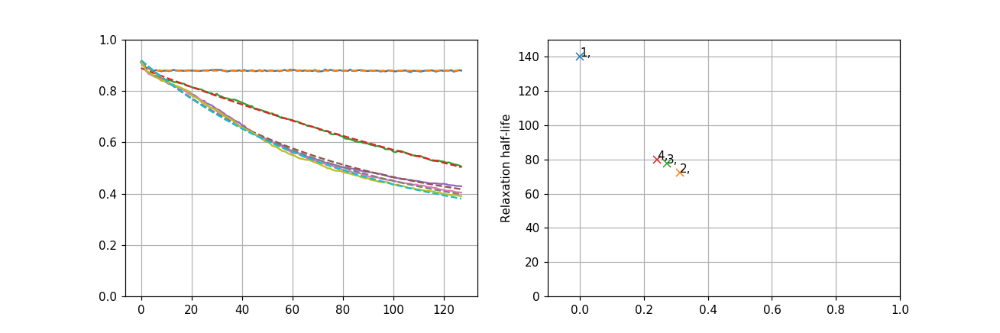

3.696642E-06 [0.87933965 1.85542618 0.03547069]
2.388025E-05 [-1.42234232e-01  2.71017239e+02  1.03148570e+00]
1.049072E-04 [ 0.31345765 72.13489692  0.60565752]
7.339032E-05 [ 0.27151745 77.65484122  0.64599243]
9.817975E-05 [ 0.24170388 80.08195346  0.67860349]


In [177]:
o = worker0325(dct=out_dct[6410],as_raw=1)
plotter3(o)

<IPython.core.display.Javascript object>


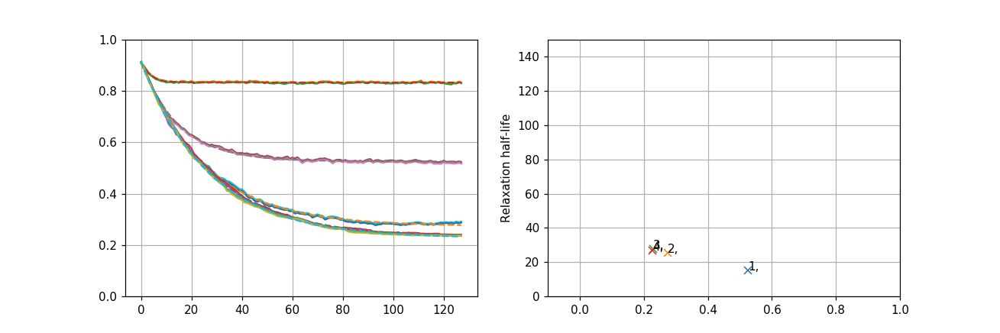

6.105608E-06 [0.83333619 3.71477218 0.08097006]
1.826091E-05 [ 0.52560465 14.98285486  0.3863342 ]
2.189610E-05 [ 0.27344345 25.24011703  0.64456748]
1.865194E-05 [ 0.2286729  27.70834794  0.68545446]
1.411384E-05 [ 0.22683391 26.90962761  0.69065838]


In [167]:
o = worker0325(dct=out_dct[7832],as_raw=1)
plotter3(o)

<IPython.core.display.Javascript object>


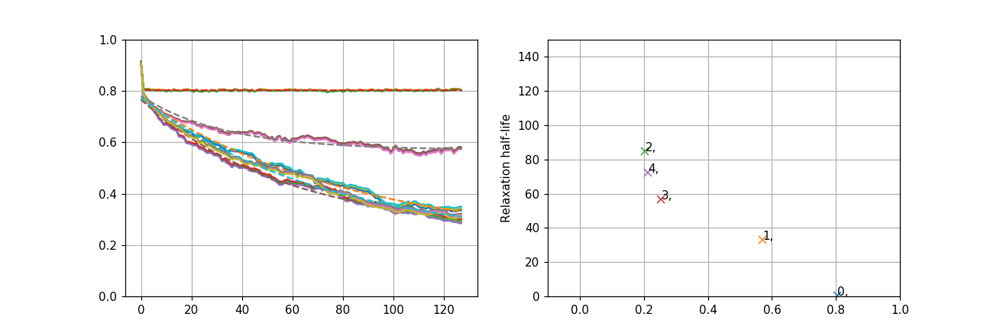

5.950900E-06 [0.80312748 0.34530308 0.10645273]
2.911991E-04 [ 0.57006584 32.96643339  0.21074699]
3.019209E-04 [ 0.20394486 84.91611321  0.56370409]
3.099232E-04 [ 0.25393919 56.91246036  0.51289611]
2.937950E-04 [ 0.2128519  72.48272508  0.56047018]


In [173]:
env = CA_sys()
env.alias= 'B3ai4aS3i4a5ai6ac7c8'
env.alias2rulestr()
# o = worker0325(env.as_config(),ps=10**np.linspace(0,-1,5),as_raw=1)
# tst_out = np.vstack([tst_out,[o]])
plotter3(o)

# worker
# print  env.as_config()
# ??worker
# lview(env)
def plotter3(o,ps=None,ylim=[0,150],axs = None,silent=0,lab=''):
    MAX = ylim[1] if ylim else 150     
#     MAX = ylim[1] if ylim else 1 
#     MAX = 0.5
    arr = np.mean(o,axis=-1)
    ERR = np.stderr(o,axis=-1)
    if axs is None:
        fig,axs= plt.subplots(1,2,figsize=[12,4])
#     xs = np.arange(arr.shape[1])
#     print lab
    for i,(ys,e) in enumerate(zip(arr,ERR) ):
        popt,yfit,loss = fit_exp(ys)
        plt.sca(axs[0])
        plt.plot(ys)
#         plt.plot(ys+e)
#         plt.plot(ys-e)
        plt.plot(yfit,'--')
        plt.sca(axs[1])
        if not silent:
            print '%3E'%loss,popt
        if popt[2]>.1:
#         if 1:
            x,y= max(0,popt[0]),min(popt[1],MAX-10)
            plt.plot(x,y,'x')
#             plt.annotate(lab,xy=(x,y))
            plt.annotate('%d,%s'%(i,lab),xy=(x,y))
#         print popt
#         plt.scatter(popt[0],min(1/popt[1],MAX))
    plt.sca(axs[0])
    plt.ylim(0,1)
    plt.grid()
    plt.sca(axs[1])
    plt.ylabel('Relaxation half-life')
    plt.xlim(-0.1,1)
    plt.ylim(ylim)
    plt.grid()

#     plt.show()

In [324]:
d = workers.worker0323(dct={'family':'2dntca','rulestr':o.rulestr})
d['grade']='fn'
data = np.load('data_pdist/reference.npy').tolist()
data.append(d)
np.save('data_pdist/reference.npy',data)


In [178]:
hist = KBs.sample(o)
plt.figure()
plt.imshow(hist[:,0].reshape((len(hist),-1)))


In [288]:
general = '''
1315
7820
7771
8956
12073

30185
17317
18275
23207
22457
23826
25095
27200
29999
30815
35715
33579
'''


# bottom left
bl='''
11602
11681
21713
'''

good='''
27200
30815
13330
35888
33579'''

amazing='''
8631
28852
28081
9240
'''
replicator = '''
8433
24502
'''
anti='''
28052
30668'''